In [140]:
import pandas as pd
from matplotlib import pyplot as plt
import missingno as msno

import numpy as np
import plotly.figure_factory as ff
import seaborn as sns
import plotly.graph_objects as go

import plotly.io as pio
# pio.renderers.default = 'notebook'

### Data Loading

In [141]:
df = pd.read_csv("./data/my_example_data.csv", parse_dates=['Date'], index_col=['Date'])
df.head()

,OXO-5FI635C Augusta,OXO-5FI661A Augusta,OXO-5FI696 Augusta,OXO-5FIC132 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,OXO-5FIC606A Augusta,OXO-5FIC606C Augusta,...,OXO-5TIC603 Augusta,OXO-5TIC604 Augusta,OXO-5TIC605 Augusta,OXO-5TIC606 Augusta,OXO-5TIC607 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta,OXO-_5FI659A Augusta,OXO-_5FI660A Augusta,OXO-_5FI662A Augusta
Date,,,,,,,,,,,,,,,,,,,,,
2019-11-01 00:00:00,5859.125648,23345.857389,9830.200195,4.450549,2076.174093,67.208298,5069.174366,0.0,NaN,1.202029,...,133.996300,130.578919,133.007764,134.032267,130.899539,298.029910,21719.630615,22870.976318,22026.824772,22036.315560
2019-11-01 01:00:00,5950.173837,23346.553467,9384.632992,4.410112,2070.199284,67.204392,5068.014148,0.0,NaN,1.158160,...,133.994588,130.640505,132.966600,134.035076,130.849780,298.084330,21727.622575,22879.205452,22042.948193,22056.644971
2019-11-01 02:00:00,6379.102250,23430.336545,9233.277262,4.285714,2067.933828,67.031974,5069.603650,0.0,NaN,1.070420,...,134.008106,130.675602,133.035094,134.001994,130.743083,297.930878,21836.766659,22970.057215,22156.774258,22105.218684
2019-11-01 03:00:00,6337.343084,23384.694743,9223.139014,4.775281,2062.488529,66.808810,5061.608939,0.0,NaN,1.044098,...,134.008312,130.613462,133.000552,133.979115,130.760757,298.052583,21783.450505,22920.952018,22088.356950,22064.178402
2019-11-01 04:00:00,6183.590302,23357.085677,9104.168620,4.388889,2055.162223,66.354369,5004.132636,0.0,NaN,1.044098,...,134.002098,130.614549,133.004748,134.000492,130.814450,298.039928,21748.715137,22895.312126,22073.622298,22053.480892


In [142]:
df.columns

Index(['OXO-5FI635C Augusta', 'OXO-5FI661A Augusta', 'OXO-5FI696 Augusta',
       'OXO-5FIC132 Augusta', 'OXO-5FIC600 Augusta', 'OXO-5FIC601 Augusta',
       'OXO-5FIC602 Augusta', 'OXO-5FIC603 Augusta', 'OXO-5FIC606A Augusta',
       'OXO-5FIC606C Augusta', 'OXO-5FIC607 Augusta', 'OXO-5FIC609A Augusta',
       'OXO-5FIC609B Augusta', 'OXO-5FIC611A Augusta', 'OXO-5FIC611B Augusta',
       'OXO-5FIC612A Augusta', 'OXO-5FIC612B Augusta', 'OXO-5FIC618A Augusta',
       'OXO-5FIC618B Augusta', 'OXO-5FIC618C Augusta', 'OXO-5FIC618D Augusta',
       'OXO-5FIC622A Augusta', 'OXO-5FIC622B Augusta', 'OXO-5FIC622C Augusta',
       'OXO-5FIC636A Augusta', 'OXO-5FIC636B Augusta', 'OXO-5FIC636C Augusta',
       'OXO-5FQI691B Augusta', 'OXO-5LI633B Augusta', 'OXO-5LI650F Augusta',
       'OXO-5LI651E Augusta', 'OXO-5LI651F Augusta', 'OXO-5LI652E Augusta',
       'OXO-5LI652F Augusta', 'OXO-5LI653E Augusta', 'OXO-5LI653F Augusta',
       'OXO-5LI654E Augusta', 'OXO-5LI654F Augusta', 'OXO-5LI655F Augu

In [143]:
columns = df.columns
target_list = []
for col in columns:
    for tag in ["5FI696", "5FIC612A", "5FIC612B", "5FIC600", "5FIC601"]:
        if tag in col:
            target_list.append(col)
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

In [144]:
# move target_list to the front
df = df[target_list + [col for col in df.columns if col not in target_list]]

In [145]:
df.shape

(28821, 59)

In [146]:
df.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 28821 entries, 2019-11-01 00:00:00 to 2023-04-05 21:00:00
Data columns (total 59 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   OXO-5FI696 Augusta     28124 non-null  float64
 1   OXO-5FIC600 Augusta    28149 non-null  float64
 2   OXO-5FIC601 Augusta    28147 non-null  float64
 3   OXO-5FIC612A Augusta   28148 non-null  float64
 4   OXO-5FIC612B Augusta   28219 non-null  float64
 5   OXO-5FI635C Augusta    28171 non-null  float64
 6   OXO-5FI661A Augusta    28124 non-null  float64
 7   OXO-5FIC132 Augusta    27956 non-null  float64
 8   OXO-5FIC602 Augusta    28148 non-null  float64
 9   OXO-5FIC603 Augusta    28147 non-null  float64
 10  OXO-5FIC606A Augusta   16413 non-null  float64
 11  OXO-5FIC606C Augusta   28149 non-null  float64
 12  OXO-5FIC607 Augusta    28123 non-null  float64
 13  OXO-5FIC609A Augusta   28123 non-null  float64
 14  OXO-5FIC609B August

In [147]:
# Create a dictionary to map the category to each tag
tag_df = pd.read_excel('./data/SASOL_OXO_2023_Full_Tag_List.xlsx')
tag_dict = dict(zip(tag_df['Tag'], tag_df['Category']))
print(tag_dict)

{'T2.OXO.5FI635C Augusta': 'Measurement', 'T2.OXO.5FI661A Augusta': 'Measurement', 'T2.OXO.5FI696 Augusta': 'Independent', 'T2.OXO.5FIC132 Augusta': 'Independent', 'T2.OXO.5FIC600 Augusta': 'Target', 'T2.OXO.5FIC601 Augusta': 'Target', 'T2.OXO.5FIC602 Augusta': 'Control', 'T2.OXO.5FIC603 Augusta': 'Control', 'T2.OXO.5FIC606A Augusta': 'Control', 'T2.OXO.5FIC606C Augusta': 'Control', 'T2.OXO.5FIC607 Augusta': 'Control', 'T2.OXO.5FIC609A Augusta': 'Target', 'T2.OXO.5FIC609B Augusta': 'Control', 'T2.OXO.5FIC611A Augusta': 'Control', 'T2.OXO.5FIC611B Augusta': 'Control', 'T2.OXO.5FIC612A Augusta': 'Target', 'T2.OXO.5FIC612B Augusta': 'Target', 'T2.OXO.5FIC618A Augusta': 'Control', 'T2.OXO.5FIC618B Augusta': 'Control', 'T2.OXO.5FIC618C Augusta': 'Control', 'T2.OXO.5FIC618D Augusta': 'Control', 'T2.OXO.5FIC622A Augusta': 'Control', 'T2.OXO.5FIC622B Augusta': 'Control', 'T2.OXO.5FIC622C Augusta': 'Control', 'T2.OXO.5FIC636A Augusta': 'Control', 'T2.OXO.5FIC636B Augusta': 'Control', 'T2.OXO.5F

### Missing Values Processing<a name="clean"></a>

In [148]:
df.isnull().sum()

OXO-5FI696 Augusta         697
OXO-5FIC600 Augusta        672
OXO-5FIC601 Augusta        674
OXO-5FIC612A Augusta       673
OXO-5FIC612B Augusta       602
OXO-5FI635C Augusta        650
OXO-5FI661A Augusta        697
OXO-5FIC132 Augusta        865
OXO-5FIC602 Augusta        673
OXO-5FIC603 Augusta        674
OXO-5FIC606A Augusta     12408
OXO-5FIC606C Augusta       672
OXO-5FIC607 Augusta        698
OXO-5FIC609A Augusta       698
OXO-5FIC609B Augusta       673
OXO-5FIC611A Augusta       938
OXO-5FIC611B Augusta     12503
OXO-5FIC618A Augusta       577
OXO-5FIC618B Augusta       673
OXO-5FIC618C Augusta       914
OXO-5FIC618D Augusta       697
OXO-5FIC622A Augusta       698
OXO-5FIC622B Augusta       698
OXO-5FIC622C Augusta       673
OXO-5FIC636A Augusta       673
OXO-5FIC636B Augusta       650
OXO-5FIC636C Augusta       626
OXO-5FQI691B Augusta       650
OXO-5LI633B Augusta        625
OXO-5LI650F Augusta        697
OXO-5LI651E Augusta        649
OXO-5LI651F Augusta        697
OXO-5LI6

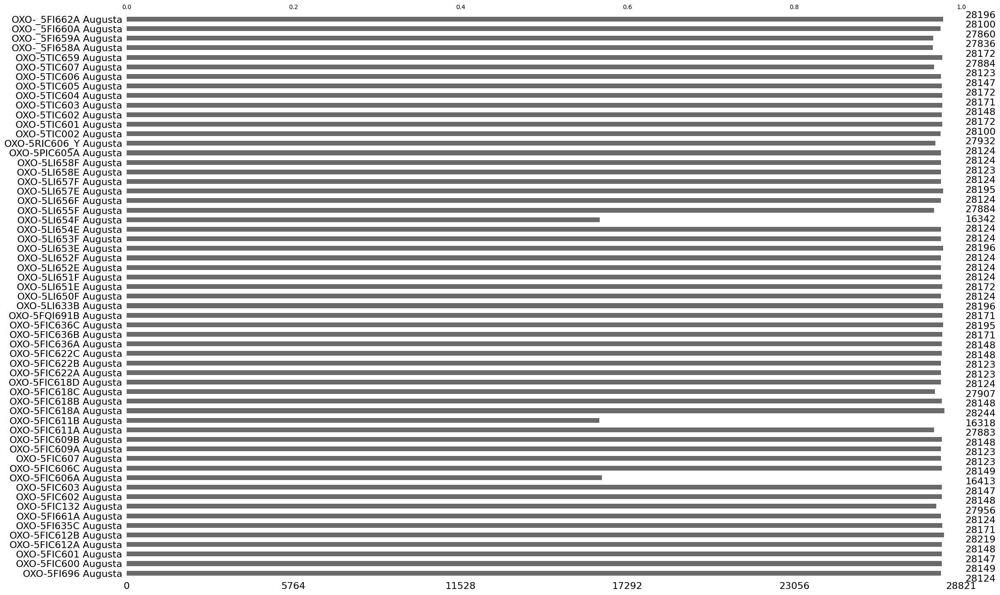

In [149]:
# Displaying a bar chart for the non-missing values of each column
msno.bar(df)
plt.show()

In [150]:
# drop rows with missing values in the target_list
df = df.dropna(subset=target_list)
df.shape

(28123, 59)

In [151]:
pd.isnull(df).sum()[pd.isnull(df).sum() / df.shape[0] > 0.4]

OXO-5FIC606A Augusta    11806
OXO-5FIC611B Augusta    11806
OXO-5LI654F Augusta     11806
dtype: int64

In [152]:
del_cols = [i for i in df.columns if df[i].isnull().sum() / df.shape[0] > 0.4]
print(del_cols)

['OXO-5FIC606A Augusta', 'OXO-5FIC611B Augusta', 'OXO-5LI654F Augusta']


In [153]:
# Check wether these three columns are our target columns
for col in del_cols:
    if col in target_list:
        print(col + " is in the target list")

In [154]:
# Check if there are deleted successfully
df.drop(columns=del_cols, inplace=True)
df.shape

(28123, 56)

In [155]:
pd.isnull(df).sum()[pd.isnull(df).sum() / df.shape[0] > 0.1]

Series([], dtype: int64)

In [156]:
# Fill the rest with missing values
fill_cols = [i for i in df.columns if df[i].isnull().sum()>0]
print(fill_cols)
print(len(fill_cols))

['OXO-5FI635C Augusta', 'OXO-5FI661A Augusta', 'OXO-5FIC132 Augusta', 'OXO-5FIC611A Augusta', 'OXO-5FIC618C Augusta', 'OXO-5LI633B Augusta', 'OXO-5LI655F Augusta', 'OXO-5RIC606_Y Augusta', 'OXO-5TIC002 Augusta', 'OXO-5TIC607 Augusta', 'OXO-_5FI658A Augusta', 'OXO-_5FI659A Augusta', 'OXO-_5FI660A Augusta', 'OXO-_5FI662A Augusta']
14


In [157]:
# # fill in the missing values with the mean of each column
# for j in fill_cols:
#     df[j]=df[j].fillna(df[j].mean())

# # Check if there is still a column that has missing values
# fill_cols = [i for i in df.columns if df[i].isnull().sum()>0]
# print(fill_cols)

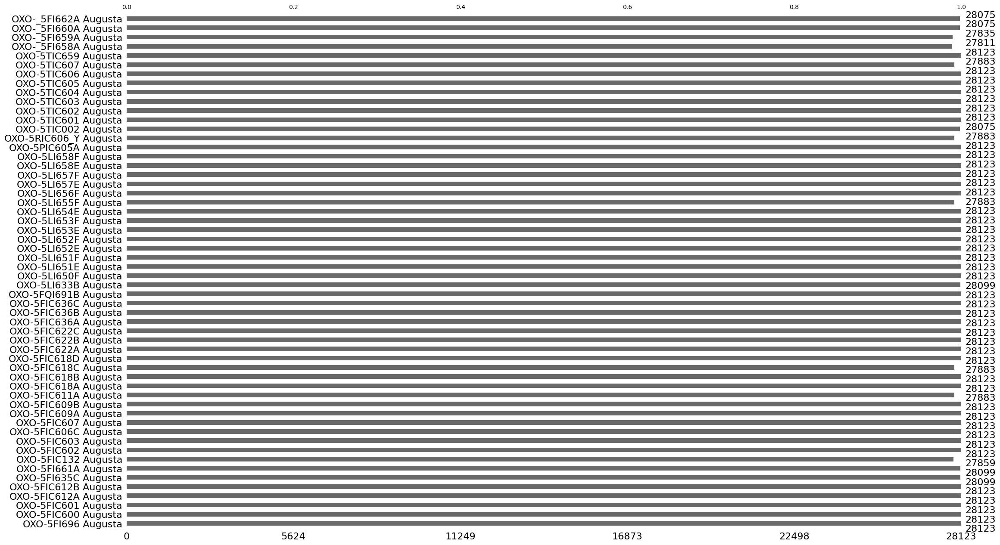

In [158]:
msno.bar(df)
plt.show()

### Outliers

In [159]:
del_cols_zero = [i for i in df.columns if (df[i]==0).sum() / len(df) > 0.5]
del_cols_zero

['OXO-5FIC607 Augusta', 'OXO-5FIC618A Augusta']

In [160]:
df = df.drop(columns=del_cols_zero)
df.shape

(28123, 54)

### Correlation Analysis<a name="clean"></a>

In [161]:
df_corr = df.corr() # Generate correlation matrix

# By default, corr() calculates the Pearson correlation coefficient between each pair of columns.
# The Pearson correlation coefficient is a measure of the linear relationship between two variables. 
# It ranges from -1 to 1, where -1 indicates a perfect negative correlation, 0 indicates no correlation, and 1 indicates a perfect positive correlation.

fig = go.Figure()
fig.add_trace(go.Heatmap(x=df_corr.columns, y=df_corr.index, z=np.array(df_corr)))
fig.update_layout(
    width=1200,
    height=1200
)
# fig.write_html("./image/corr_heatmap.html")
fig.show()

Pairs of highly correlated features:
('OXO-5FIC612A Augusta', 'OXO-5FIC609A Augusta')
('OXO-5FIC612B Augusta', 'OXO-5FIC609B Augusta')
('OXO-5FI661A Augusta', 'OXO-_5FI660A Augusta')
('OXO-5FI661A Augusta', 'OXO-_5FI662A Augusta')
('OXO-5LI651E Augusta', 'OXO-5LI651F Augusta')
('OXO-5LI652E Augusta', 'OXO-5LI652F Augusta')
('OXO-5LI653E Augusta', 'OXO-5LI653F Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC603 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC604 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC602 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC604 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC603 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC605 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC604 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC605 Augusta', 'OXO-5TIC606 Augusta')
('OXO-5TIC605 Augusta', 'OXO-5TIC607 Augusta')
('OXO-5TIC606 Augusta', 'OXO-5TIC607 Augusta')
('OXO-_5FI659A Au

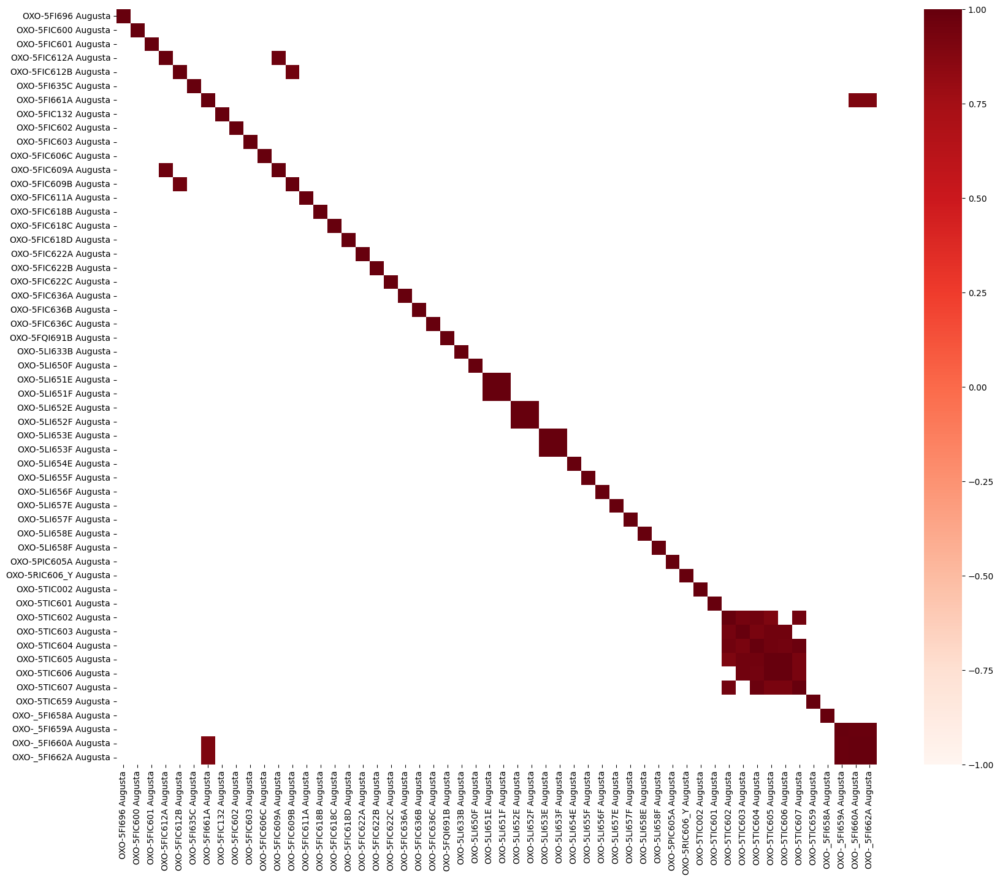

In [162]:
# Define a threshold for high correlation
threshold = 0.9

# Extract pairs of highly correlated features
high_corr_pairs = []
for i in range(len(df_corr.columns)):
    for j in range(i+1, len(df_corr.columns)):
        if abs(df_corr.iloc[i, j]) > threshold:
            high_corr_pairs.append((df_corr.columns[i], df_corr.columns[j]))

# Print the highly correlated feature pairs
print("Pairs of highly correlated features:")
for pair in high_corr_pairs:
    print(pair)

fig = plt.subplots(figsize=(20, 16))

sns.heatmap(df_corr[df_corr>0.9], vmax=1, vmin=-1, center=0, cmap = 'Reds')
# plt.savefig("./image/corr_matrix.png", dpi=300)
plt.show()

In [163]:
# # Drop highly correlated columns
# drop_cols = ['OXO-5FIC609A Augusta',
#                       'OXO-5FIC609B Augusta', 
#                       'OXO-5FI661A Augusta',
#                       'OXO-5LI651E Augusta',
#                       'OXO-5LI652E Augusta',
#                       'OXO-5LI653E Augusta',
#                       'OXO-5TIC602 Augusta',
#                       'OXO-5TIC603 Augusta',
#                       'OXO-5TIC604 Augusta',
#                       'OXO-5TIC605 Augusta',
#                       'OXO-5TIC606 Augusta',
#                       'OXO-5TIC607 Augusta',
#                       'OXO-_5FI659A Augusta',
#                       'OXO-_5FI660A Augusta',
#                       'OXO-_5FI662A Augusta']

# # If the Category lable of that tag is 'Control', we don't drop it
# for col in drop_cols:
#     col_origin = col.replace('OXO-', 'T2.OXO.')
#     if  tag_dict[col_origin] == 'Control':
#         drop_cols.remove(col)

# drop_cols

In [164]:
# df = df.drop(columns=drop_cols)
# df.head()

In [165]:
df.shape

(28123, 54)

In [166]:
# from BorutaShap import BorutaShap
# # from sklearn.datasets import load_boston

# X = df.drop(columns=['OXO-5FI696 Augusta'])
# # input_columns = df.loc[:, df.columns != "class"]
# y = df['OXO-5FI696 Augusta']

# Feature_Selector = BorutaShap(importance_measure='shap', classification=False)
# Feature_Selector.fit(X=X, y=y, n_trials=100, random_state=0)

# # Check selected features
# print(Feature_Selector.Subset())

## Target Variables Distribution<a name="clean"></a>

In [167]:
import plotly.express as px

fig = px.line(df, x=df.index, y=target_list)
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

Output: OXO-5FI696 Augusta

In [168]:
# Check the output, 'OXO-5FI696 Augusta', when it drop down to 0
# Focus on the last three variables

fig = px.line(df, x=df.index, y=target_list[0])
fig.update_layout(
    width=1200,
    height=600,
    yaxis=dict(range=[0, 10])
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [169]:
# find indices where value goes below the threshold

threshold = 2000

zero_indices = df[df['OXO-5FI696 Augusta'] < threshold].index
print(zero_indices.shape)

# output timestamps
# for index in zero_indices:
#     print(df['Date'][index])

# delete rows
df = df.drop(zero_indices)

(2091,)


In [170]:
df.shape

(26032, 54)

In [171]:
# Check if rows are deleted successfully
df.loc[(df.index >= '2021-03-06') & (df.index < '2021-03-07')]

,OXO-5FI696 Augusta,OXO-5FIC600 Augusta,OXO-5FIC601 Augusta,OXO-5FIC612A Augusta,OXO-5FIC612B Augusta,OXO-5FI635C Augusta,OXO-5FI661A Augusta,OXO-5FIC132 Augusta,OXO-5FIC602 Augusta,OXO-5FIC603 Augusta,...,OXO-5TIC603 Augusta,OXO-5TIC604 Augusta,OXO-5TIC605 Augusta,OXO-5TIC606 Augusta,OXO-5TIC607 Augusta,OXO-5TIC659 Augusta,OXO-_5FI658A Augusta,OXO-_5FI659A Augusta,OXO-_5FI660A Augusta,OXO-_5FI662A Augusta
Date,,,,,,,,,,,,,,,,,,,,,


In [172]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

'OXO-5FIC601 Augusta', 'OXO-5FIC612A Augusta' and 'OXO-5FIC612B Augusta'

In [173]:
# Focus on the last three variables

fig = px.line(df, x=df.index, y=target_list[2:])
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

'OXO-5FIC612A Augusta' and 'OXO-5FIC612B Augusta'

In [174]:
# Focus on the last two variables

fig = px.line(df, x=df.index, y=target_list[3:])
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [175]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

KPI1 Variation

In [176]:
# Let's check KPI1
kpi = df[target_list[0]] / ((df[target_list[3]] + df[target_list[4]])*1000 + df[target_list[1]] + df[target_list[2]])

fig = px.line(df, x=df.index, y=kpi)
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [177]:
# View the value between 0 and 1.5, mark the data points out of [0.84, 0.9] as red

fig = px.line(df, x=df.index, y=kpi)
fig.update_layout(
    width=1200,
    height=600,
    yaxis=dict(range=[0, 1.5])
)
fig.add_shape(
        # Line Horizontal
        type="line",
        x0=df.index[0],
        y0=0.84,
        x1=df.index[-1],
        y1=0.84,
        line=dict(
            color="Red",
            width=2,
            dash="dashdot",
        ),
    )
fig.add_shape(
        # Line Horizontal
        type="line",
        x0=df.index[0],
        y0=0.9,
        x1=df.index[-1],
        y1=0.9,
        line=dict(
            color="Red",
            width=2,
            dash="dashdot",
        ),
    )
# fig.add_trace(go.Scatter(
#     x=df.index,
#     y=kpi,
#     mode="markers",
#     marker=dict(
#         color='rgba(255, 0, 0, 0.5)',
#         size=5,
#         line=dict(
#             color='DarkSlateGrey',
#             width=2
#         )
#     )
# ))
# fig.write_html("./image/target_variables.html")
fig.show()

## Variance Analysis<a name="clean"></a>

In [178]:
std = df.std()
std.shape

(54,)

In [179]:
std

OXO-5FI696 Augusta         2033.348075
OXO-5FIC600 Augusta         341.776556
OXO-5FIC601 Augusta          19.215577
OXO-5FIC612A Augusta          3.625967
OXO-5FIC612B Augusta          3.242087
OXO-5FI635C Augusta        2211.450356
OXO-5FI661A Augusta        8498.312469
OXO-5FIC132 Augusta        3241.966264
OXO-5FIC602 Augusta        2635.499807
OXO-5FIC603 Augusta        2789.754798
OXO-5FIC606C Augusta        675.950039
OXO-5FIC609A Augusta       1033.048558
OXO-5FIC609B Augusta        920.413096
OXO-5FIC611A Augusta       3323.050954
OXO-5FIC618B Augusta       1343.547510
OXO-5FIC618C Augusta       1229.581713
OXO-5FIC618D Augusta       1101.514992
OXO-5FIC622A Augusta        987.688188
OXO-5FIC622B Augusta        766.895742
OXO-5FIC622C Augusta        854.008795
OXO-5FIC636A Augusta       3243.723161
OXO-5FIC636B Augusta       3645.336877
OXO-5FIC636C Augusta       1180.842262
OXO-5FQI691B Augusta     169514.606528
OXO-5LI633B Augusta        1946.820529
OXO-5LI650F Augusta      

In [180]:
fig = go.Figure(data=[go.Bar(x=df.columns, y=std)])
fig.update_layout(
    width=1200,
    height=600
)
fig.show()

In [181]:
# Take a look at that weird tag
fig = px.line(df, x=df.index, y='OXO-5FQI691B Augusta')
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [182]:
# It's because the magnitude of the values in that column are large
# Let's try normalized std

norm_std = df.std(ddof=0) / df.mean()
norm_std

OXO-5FI696 Augusta        0.200939
OXO-5FIC600 Augusta       0.163088
OXO-5FIC601 Augusta       0.257877
OXO-5FIC612A Augusta      1.185159
OXO-5FIC612B Augusta      0.492688
OXO-5FI635C Augusta       0.365089
OXO-5FI661A Augusta       0.276336
OXO-5FIC132 Augusta       0.996622
OXO-5FIC602 Augusta       0.646853
OXO-5FIC603 Augusta       0.769007
OXO-5FIC606C Augusta      0.876633
OXO-5FIC609A Augusta      1.189035
OXO-5FIC609B Augusta      0.497240
OXO-5FIC611A Augusta      1.459811
OXO-5FIC618B Augusta      0.432151
OXO-5FIC618C Augusta      0.300534
OXO-5FIC618D Augusta      0.360036
OXO-5FIC622A Augusta      1.159086
OXO-5FIC622B Augusta      0.353264
OXO-5FIC622C Augusta      0.374469
OXO-5FIC636A Augusta      0.851385
OXO-5FIC636B Augusta      0.928446
OXO-5FIC636C Augusta      0.698769
OXO-5FQI691B Augusta      0.529788
OXO-5LI633B Augusta       0.873857
OXO-5LI650F Augusta       0.949280
OXO-5LI651E Augusta       0.852301
OXO-5LI651F Augusta       0.830852
OXO-5LI652E Augusta 

In [183]:
fig = go.Figure(data=[go.Bar(x=df.columns, y=norm_std)])
fig.update_layout(
    width=1200,
    height=600
)
fig.show()

In [184]:
# Take a look at that weird tag

fig = px.line(df, x=df.index, y='OXO-5RIC606_Y Augusta')
fig.update_layout(
    width=1200,
    height=600
)
# fig.write_html("./image/target_variables.html")
fig.show()

In [185]:
# That column has lots of spikes, and also remain in 0 for a long time, so we decided to drop it.

df = df.drop(columns=['OXO-5RIC606_Y Augusta'])
df.shape

(26032, 53)

In [186]:
# Check for extremely small variance

small_std = [x for x in norm_std if x < 0.1]
small_std

[0.0725532695919991,
 0.07028099173088422,
 0.042112434311244694,
 0.05010181529967062,
 0.05096975239079607,
 0.0444715073510278]

## Anomaly Detection<a name="clean"></a>

In [180]:
import plotly.graph_objects as go

# Create a box plot with outliers highlighted
fig = go.Figure()
fig.add_trace(go.Box(y=df[target_list[0]], boxpoints='outliers'))
fig.show()

In [181]:
from sklearn.metrics import r2_score, median_absolute_error, mean_absolute_error
from sklearn.metrics import median_absolute_error, mean_squared_error, mean_squared_log_error

def mean_absolute_percentage_error(y_true, y_pred): 
    return np.mean(np.abs((y_true - y_pred) / y_true)) * 100


def plotMovingAverage(series, window, plot_intervals=False, scale=1.96, plot_anomalies=False):

    """
        series - dataframe with timeseries
        window - rolling window size 
        plot_intervals - show confidence intervals
        plot_anomalies - show anomalies 
    """
    
    rolling_mean = series.rolling(window=window).mean()

    plt.figure(figsize=(25,10))
    plt.title("Anomaly Detection: Moving average with window size = {}".format(window))
    plt.plot(rolling_mean, "g", label="Rolling mean trend")

    # Plot confidence intervals for smoothed values
    if plot_intervals:
        mae = mean_absolute_error(series[window:], rolling_mean[window:])
        deviation = np.std(series[window:] - rolling_mean[window:])
        lower_bond = rolling_mean - (mae + scale * deviation)
        upper_bond = rolling_mean + (mae + scale * deviation)
        plt.plot(upper_bond, "r--", label="Upper Bond / Lower Bond")
        plt.plot(lower_bond, "r--")
        
        # Having the intervals, find abnormal values
        if plot_anomalies:
            anomalies = pd.DataFrame(index=series.index, columns=series.columns)
            anomalies[series<lower_bond] = series[series<lower_bond]
            anomalies[series>upper_bond] = series[series>upper_bond]
            plt.plot(anomalies, "ro", markersize=10)
        
    plt.plot(series[window:], label="Actual values")
    plt.legend(loc="upper left")
    plt.grid(True)


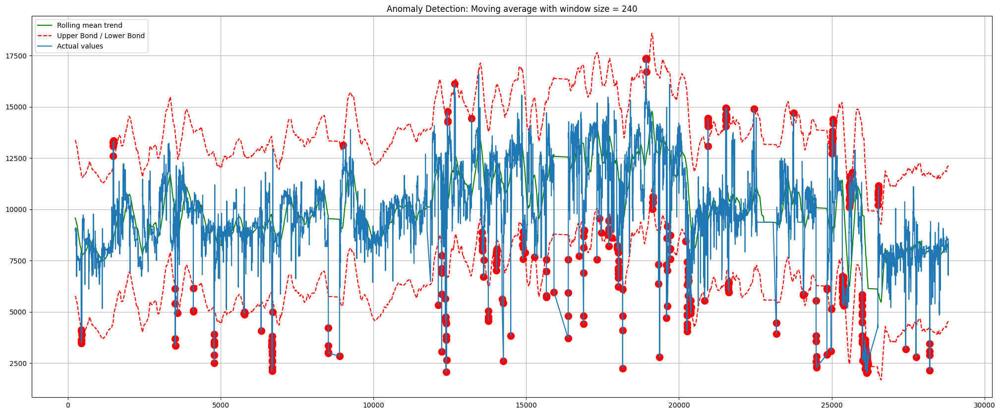

In [182]:
plotMovingAverage(df[target_list[0]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

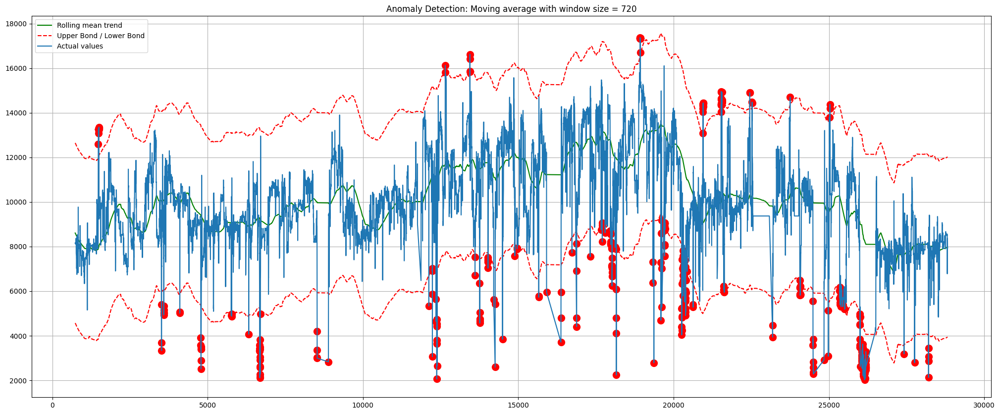

In [183]:
plotMovingAverage(df[target_list[0]].to_frame(), window=24*30, plot_intervals=True, plot_anomalies=True)


In [184]:
target_list

['OXO-5FI696 Augusta',
 'OXO-5FIC600 Augusta',
 'OXO-5FIC601 Augusta',
 'OXO-5FIC612A Augusta',
 'OXO-5FIC612B Augusta']

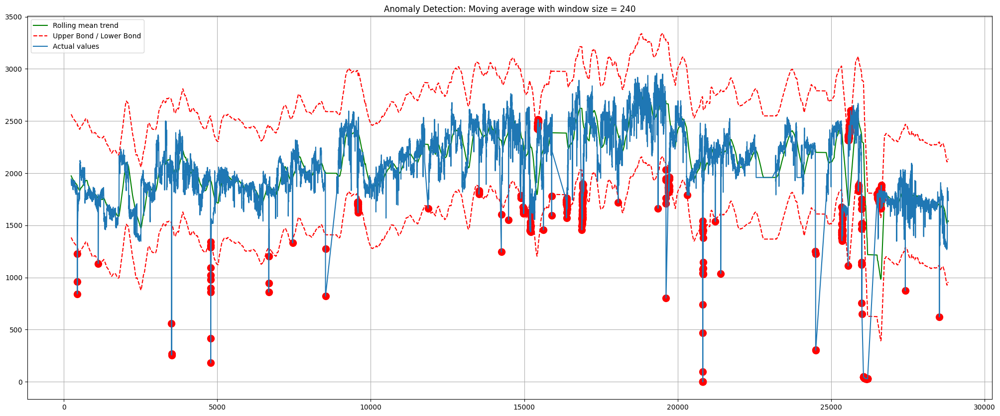

In [185]:
plotMovingAverage(df[target_list[1]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

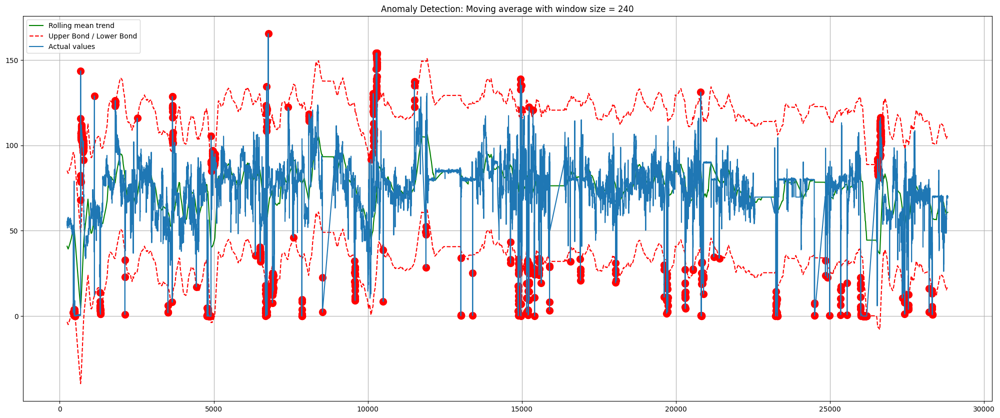

In [186]:
plotMovingAverage(df[target_list[2]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

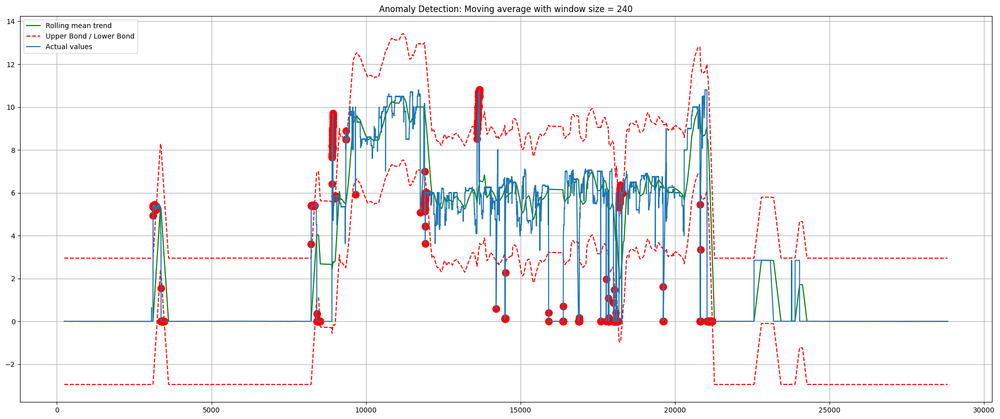

In [187]:
plotMovingAverage(df[target_list[3]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

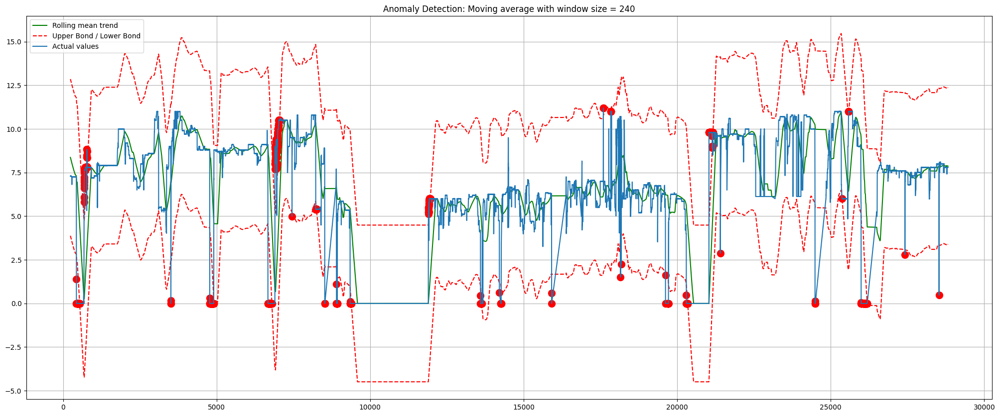

In [188]:
plotMovingAverage(df[target_list[4]].to_frame(), window=24*10, plot_intervals=True, plot_anomalies=True)

## ML Model<a name="clean"></a>

In [ ]:
from sklearn.preprocessing import MinMaxScaler
from numpy import concatenate

In [499]:
# convert series to supervised learning
def series_to_supervised(data, n_in=1, n_out=1, dropnan=True):
	n_vars = 1 if type(data) is list else data.shape[1]
	df = pd.DataFrame(data)
	cols, names = list(), list()
	# input sequence (t-n, ... t-1)
	for i in range(n_in, 0, -1):
		cols.append(df.shift(i))
		names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
	# forecast sequence (t, t+1, ... t+n)
	for i in range(0, n_out):
		cols.append(df.shift(-i))
		if i == 0:
			names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
		else:
			names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
	# put it all together
	agg = pd.concat(cols, axis=1)
	agg.columns = names
	# drop rows with NaN values
	if dropnan:
		agg.dropna(inplace=True)
	return agg

In [500]:
def data_preparation_lstm(timesteps=3, n_features=44, df=df):
    # load dataset
    df_2 = df.set_index('Date')
    values = df_2.values

    # ensure all data is float
    values = values.astype('float32')
    print(values.shape)

    # normalize features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)

    # split into train and test sets
    train_size = int(0.8 * len(df))
    val_size = int(0.1 * len(df))
    test_size = len(df) - train_size - val_size

    train = scaled[:train_size, :]
    val = scaled[train_size: train_size + val_size, :]
    test = scaled[-test_size:, :]

    # frame as supervised learning
    train = series_to_supervised(train, timesteps, 1)
    print("train set prefiew: \n", train)
    train = train.values
    val = series_to_supervised(val, timesteps, 1).values
    test = series_to_supervised(test, timesteps, 1).values

    # split into input and outputs
    # with timesteps=3, we train on var1(t-3) - var44(t-3), var1(t-2) - var44(t-2), var1(t-1) - var44(t-1) to test var1(t)
    n_obs = timesteps * n_features
    train_X, train_y = train[:, :n_obs], train[:, -n_features]
    val_X, val_y = val[:, :n_obs], val[:, -n_features]
    test_X, test_y = test[:, :n_obs], test[:, -n_features]

    # reshape input to be 3D [samples, timesteps, features
    train_X = train_X.reshape((train_X.shape[0], timesteps, n_features))
    val_X = val_X.reshape((val_X.shape[0], timesteps, n_features))
    test_X = test_X.reshape((test_X.shape[0], timesteps, n_features))

    print(train_X.shape, train_y.shape, val_X.shape, val_y.shape, test_X.shape, test_y.shape)
    
    return train_X, train_y, val_X, val_y, test_X, test_y


### LSTM

#### TimeStemp = 3

Data Preparation

In [501]:
df.shape

(26729, 45)

In [502]:
timesteps = 3
n_features = 44
train_X, train_y, val_X, val_y, test_X, test_y = data_preparation_lstm(timesteps, n_features, df)

(26729, 44)
train set prefiew: 
        var1(t-3)  var2(t-3)  var3(t-3)  var4(t-3)  var5(t-3)  var6(t-3)   
3       0.509042   0.702033   0.406147   0.000866   0.803311   0.689309  \
4       0.480015   0.700013   0.406123   0.000819   0.803541   0.700020   
5       0.470154   0.699247   0.405081   0.000851   0.803422   0.750483   
6       0.469494   0.697406   0.403733   0.000861   0.803305   0.745570   
7       0.461743   0.694929   0.400987   0.000835   0.803378   0.727481   
...          ...        ...        ...        ...        ...        ...   
21378   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21379   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21380   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21381   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21382   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   

       var7(t-3)  var8(t-3)  var9(t-3)  var10(t-3)  ...  var35(t) 

Train

In [503]:
from tensorflow import keras
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.layers import LSTM
from tensorflow.keras import regularizers
keras.__version__
from sklearn.metrics import mean_squared_error,r2_score

In [504]:
model = Sequential()
# model.add(LSTM(units=32, activation='relu', input_shape=(x_train.shape[1], x_train.shape[2])))

model.add(LSTM(units=32, return_sequences=False, input_shape=(train_X.shape[1], train_X.shape[2]), kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001)))
# model.add(LSTM(units=32, return_sequences=False, input_shape=(train_X.shape[1], train_X.shape[2]), kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001), dropout=0.2, recurrent_dropout=0.2))
# model.add(LSTM(units=32, kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001), dropout=0.2, recurrent_dropout=0.2))

# model.add(Dropout(0.2))
model.add(Dense(units = 1))

optimizer = keras.optimizers.Adam(lr=0.01)
# model.compile(optimizer = 'adam', loss = 'mean_squared_error')
model.compile(optimizer = optimizer, loss = 'mae')
model.summary()


Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_22 (LSTM)              (None, 32)                9856      
                                                                 
 dense_22 (Dense)            (None, 1)                 33        
                                                                 
Total params: 9,889
Trainable params: 9,889
Non-trainable params: 0
_________________________________________________________________


Epoch 1/16
669/669 [==============================] - 7s 4ms/step - loss: 0.1276 - val_loss: 0.1318
Epoch 2/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0837 - val_loss: 0.0789
Epoch 3/16
669/669 [==============================] - 2s 4ms/step - loss: 0.0741 - val_loss: 0.0696
Epoch 4/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0668 - val_loss: 0.0559
Epoch 5/16
669/669 [==============================] - 2s 4ms/step - loss: 0.0610 - val_loss: 0.0589
Epoch 6/16
669/669 [==============================] - 2s 4ms/step - loss: 0.0575 - val_loss: 0.0459
Epoch 7/16
669/669 [==============================] - 3s 4ms/step - loss: 0.0557 - val_loss: 0.0426
Epoch 8/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0535 - val_loss: 0.0419
Epoch 9/16
669/669 [==============================] - 2s 4ms/step - loss: 0.0518 - val_loss: 0.0407
Epoch 10/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0500 - val_loss: 0.0396

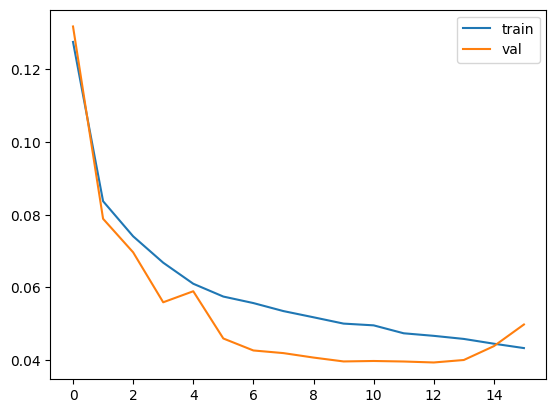

In [505]:
# history = model.fit(train_X, train_y, epochs = 16, batch_size = 32)
history = model.fit(train_X, train_y, epochs=16, batch_size=32, validation_data=(val_X, val_y), shuffle=False) # do not shuffle on time series data

plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='val')
plt.legend()
plt.show()

Validation

84/84 [==============================] - 1s 2ms/step


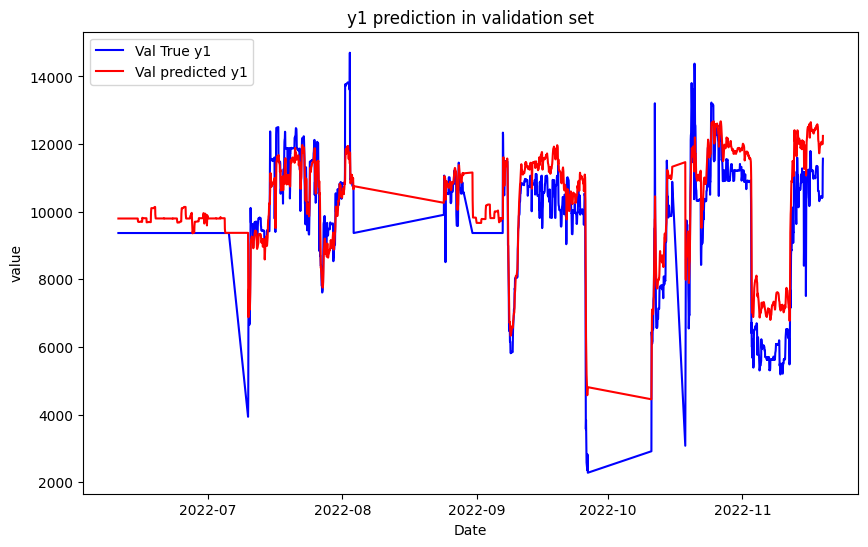

In [506]:
val_yhat = model.predict(val_X)
val_X1 = val_X.reshape((val_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
inv_yhat = concatenate((val_yhat, val_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]

val_y_origin = values[train_size+timesteps: train_size + val_size, :][:, 0]


plt.figure(figsize=(10,6))
plt.plot(df['Date'][train_size+timesteps: train_size + val_size], val_y_origin, color='blue', label='Val True y1')
plt.plot(df['Date'][train_size+timesteps: train_size + val_size], inv_yhat, color='red', label='Val predicted y1')
plt.title('y1 prediction in validation set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [507]:
rmse = np.sqrt(mean_squared_error(inv_yhat, val_y_origin))
print('Validation RMSE: %.3f' % rmse)

Validation RMSE: 877.829


Test

84/84 [==============================] - 0s 2ms/step


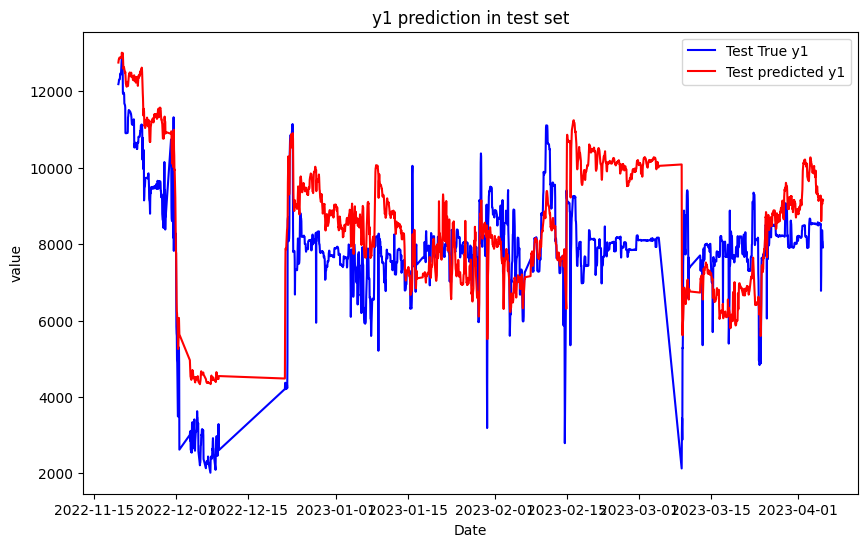

In [508]:
test_yhat = model.predict(test_X)
test_X1 = test_X.reshape((test_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
inv_yhat = concatenate((test_yhat, test_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]
# # invert scaling for actual
test_y1 = test_y.reshape((len(test_y), 1))
inv_y = concatenate((test_y1, test_X1[:, -(n_features-1):]), axis=1)
inv_y = scaler.inverse_transform(inv_y)
inv_y = inv_y[:,0]

test_y_origin = values[-test_size+timesteps:, :][:, 0]


plt.figure(figsize=(10,6))
plt.plot(df['Date'][-test_size+timesteps:], test_y_origin, color='blue', label='Test True y1')
plt.plot(df['Date'][-test_size+timesteps:], inv_yhat, color='red', label='Test predicted y1')
plt.title('y1 prediction in test set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [509]:
rmse = np.sqrt(mean_squared_error(inv_yhat, test_y_origin))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 1441.208


#### Timesteps = 1

Data Preparation

In [510]:
timesteps = 1
n_features = 44
train_X, train_y, val_X, val_y, test_X, test_y = data_preparation_lstm(timesteps)

(26729, 44)
train set prefiew: 
        var1(t-1)  var2(t-1)  var3(t-1)  var4(t-1)  var5(t-1)  var6(t-1)   
1       0.509042   0.702033   0.406147   0.000866   0.803311   0.689309  \
2       0.480015   0.700013   0.406123   0.000819   0.803541   0.700020   
3       0.470154   0.699247   0.405081   0.000851   0.803422   0.750483   
4       0.469494   0.697406   0.403733   0.000861   0.803305   0.745570   
5       0.461743   0.694929   0.400987   0.000835   0.803378   0.727481   
...          ...        ...        ...        ...        ...        ...   
21378   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21379   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21380   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21381   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   
21382   0.479094   0.662308   0.421275   0.263674   0.547015   0.661132   

       var7(t-1)  var8(t-1)  var9(t-1)  var10(t-1)  ...  var35(t) 

Train

In [511]:
model = Sequential()
model.add(LSTM(units=32, return_sequences=False, input_shape=(train_X.shape[1], train_X.shape[2]), kernel_regularizer=regularizers.l2(0.001), recurrent_regularizer=regularizers.l2(0.001)))
model.add(Dense(units = 1))
optimizer = keras.optimizers.Adam(lr=0.01)
model.compile(optimizer = optimizer, loss = 'mae')
model.summary()

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_23 (LSTM)              (None, 32)                9856      
                                                                 
 dense_23 (Dense)            (None, 1)                 33        
                                                                 
Total params: 9,889
Trainable params: 9,889
Non-trainable params: 0
_________________________________________________________________


Epoch 1/16
669/669 [==============================] - 6s 4ms/step - loss: 0.1135 - val_loss: 0.0811
Epoch 2/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0835 - val_loss: 0.0672
Epoch 3/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0700 - val_loss: 0.0573
Epoch 4/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0621 - val_loss: 0.0464
Epoch 5/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0583 - val_loss: 0.0417
Epoch 6/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0550 - val_loss: 0.0391
Epoch 7/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0521 - val_loss: 0.0404
Epoch 8/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0501 - val_loss: 0.0345
Epoch 9/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0489 - val_loss: 0.0357
Epoch 10/16
669/669 [==============================] - 2s 3ms/step - loss: 0.0487 - val_loss: 0.0358

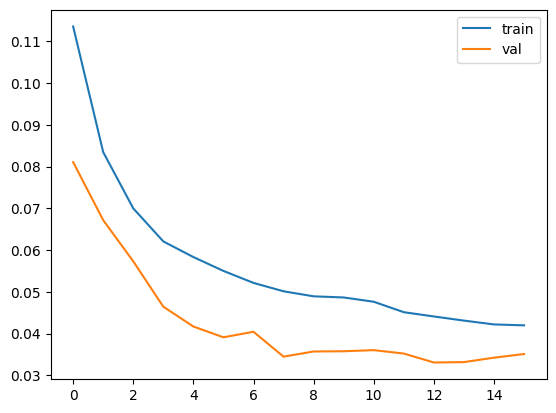

In [512]:
history = model.fit(train_X, train_y, epochs=16, batch_size=32, validation_data=(val_X, val_y), shuffle=False) # do not shuffle on time series data

plt.plot(history.history['loss'], label='train')
plt.plot(history.history['val_loss'], label='val')
plt.legend()
plt.show()

Validation

84/84 [==============================] - 1s 2ms/step
(2671, 1)


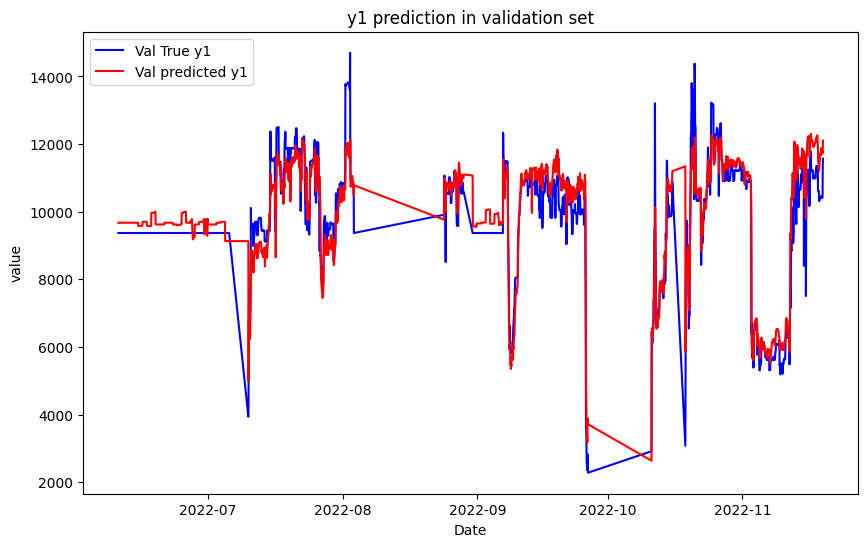

In [513]:
val_yhat = model.predict(val_X)
print(val_yhat.shape)
val_X1 = val_X.reshape((val_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
inv_yhat = concatenate((val_yhat, val_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]

val_y_origin = values[train_size+timesteps: train_size + val_size, :][:, 0]


plt.figure(figsize=(10,6))
plt.plot(df['Date'][train_size+timesteps: train_size + val_size], val_y_origin, color='blue', label='Val True y1')
plt.plot(df['Date'][train_size+timesteps: train_size + val_size], inv_yhat, color='red', label='Val predicted y1')
plt.title('y1 prediction in validation set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [514]:
rmse = np.sqrt(mean_squared_error(inv_yhat, val_y_origin))
print('Validation RMSE: %.3f' % rmse)

Validation RMSE: 630.107


Test

84/84 [==============================] - 0s 2ms/step


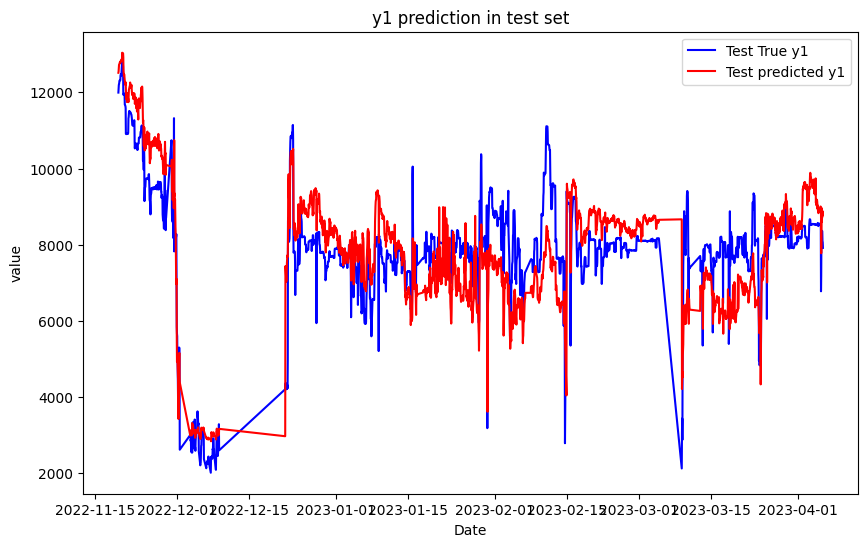

In [515]:
test_yhat = model.predict(test_X)
test_X1 = test_X.reshape((test_X.shape[0], timesteps*n_features))

# # invert scaling for forecast
inv_yhat = concatenate((test_yhat, test_X1[:, -(n_features-1):]), axis=1)
inv_yhat = scaler.inverse_transform(inv_yhat)
inv_yhat = inv_yhat[:,0]

test_y_origin = values[-test_size+timesteps:, :][:, 0]


plt.figure(figsize=(10,6))
plt.plot(df['Date'][-test_size+timesteps:], test_y_origin, color='blue', label='Test True y1')
plt.plot(df['Date'][-test_size+timesteps:], inv_yhat, color='red', label='Test predicted y1')
plt.title('y1 prediction in test set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [516]:
rmse = np.sqrt(mean_squared_error(inv_yhat, test_y_origin))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 1022.338


### XGBoost

In [517]:
from numpy import asarray
from xgboost import XGBRegressor
from sklearn.model_selection import GridSearchCV

Data Preparation

In [518]:
def data_preparation_xgboost(timesteps=0, n_features=43, df=df):
    df_2 = df.set_index('Date')
    values = df_2.values
    values = values.astype('float32')
    print(values.shape)

    # split into train and test sets
    train_size = int(0.8 * len(df))
    val_size = int(0.1 * len(df))
    test_size = len(df) - train_size - val_size

    train = values[:train_size, :].copy()
    val = values[train_size: train_size + val_size, :].copy()
    test = values[-test_size:, :].copy()

    # frame as supervised learning
    train = series_to_supervised(train, timesteps, 1)
    print("train set prefiew: \n", train)
    train = train.values
    val = series_to_supervised(val, timesteps, 1).values
    test = series_to_supervised(test, timesteps, 1).values

    # split into input and outputs
    train_X, train_y = train[:, 1:], train[:, 0]
    val_X, val_y = val[:, 1:], val[:, 0]
    test_X, test_y = test[:, 1:], test[:, 0]
    print(train_X.shape, train_y.shape, val_X.shape, val_y.shape, test_X.shape, test_y.shape)
    
    return train_X, train_y, val_X, val_y, test_X, test_y


In [519]:
timesteps = 0
n_features = 43
train_X, train_y, val_X, val_y, test_X, test_y = data_preparation_xgboost(
    timesteps, n_features, df)

(26729, 44)
train set prefiew: 
            var1(t)      var2(t)    var3(t)   var4(t)   var5(t)      var6(t)   
0      9830.200195  2076.174072  67.208298  0.009363  8.997839  5859.125488  \
1      9384.632812  2070.199219  67.204391  0.008853  9.000415  5950.173828   
2      9233.277344  2067.933838  67.031975  0.009193  8.999083  6379.102051   
3      9223.138672  2062.488525  66.808807  0.009306  8.997775  6337.343262   
4      9104.168945  2055.162109  66.354370  0.009023  8.998596  6183.590332   
...            ...          ...        ...       ...       ...          ...   
21378  9370.497070  1958.690063  69.711578  2.849256  6.127079  5619.620605   
21379  9370.497070  1958.690063  69.711578  2.849256  6.127079  5619.620605   
21380  9370.497070  1958.690063  69.711578  2.849256  6.127079  5619.620605   
21381  9370.497070  1958.690063  69.711578  2.849256  6.127079  5619.620605   
21382  9370.497070  1958.690063  69.711578  2.849256  6.127079  5619.620605   

           var7(t)

Train

In [520]:
# param_grid = {
#     'n_estimators': [50, 100, 200],
#     'max_depth': [5, 7, 9],
#     'learning_rate': [0.01, 0.1, 1]
# }
param_grid = {}

# cv = [(list(range(train_size)), list(range(train_size, train_size + val_size)))]
# cv = (list(range(train_size)))

# print(cv[0][0][-1])
grid_search = GridSearchCV(
    XGBRegressor(colsample_bytree=0.2, gamma=0.0, learning_rate=0.01, max_depth=5, min_child_weight=1.5, n_estimators=7200, reg_alpha=0.9, reg_lambda=0.6, subsample=0.2, random_state=123),
    param_grid=param_grid,
    cv=[(slice(None), slice(None))],
    return_train_score=True
)

grid_result = grid_search.fit(train_X, train_y)

In [521]:
# Get best parameters
best_params = grid_search.best_params_
print(f'Best parameters: {best_params}')

# Get best estimator
best_estimator = grid_search.best_estimator_
print(f'Best estimator: {best_estimator}')

Best parameters: {}
Best estimator: XGBRegressor(base_score=None, booster=None, callbacks=None,
             colsample_bylevel=None, colsample_bynode=None,
             colsample_bytree=0.2, early_stopping_rounds=None,
             enable_categorical=False, eval_metric=None, feature_types=None,
             gamma=0.0, gpu_id=None, grow_policy=None, importance_type=None,
             interaction_constraints=None, learning_rate=0.01, max_bin=None,
             max_cat_threshold=None, max_cat_to_onehot=None,
             max_delta_step=None, max_depth=5, max_leaves=None,
             min_child_weight=1.5, missing=nan, monotone_constraints=None,
             n_estimators=7200, n_jobs=None, num_parallel_tree=None,
             predictor=None, random_state=123, ...)


Top 3 most important features from the trained XGBoost model: ('OXO-5FIC600 Augusta', 'OXO-5FI635C Augusta', 'OXO-5FIC612A Augusta')


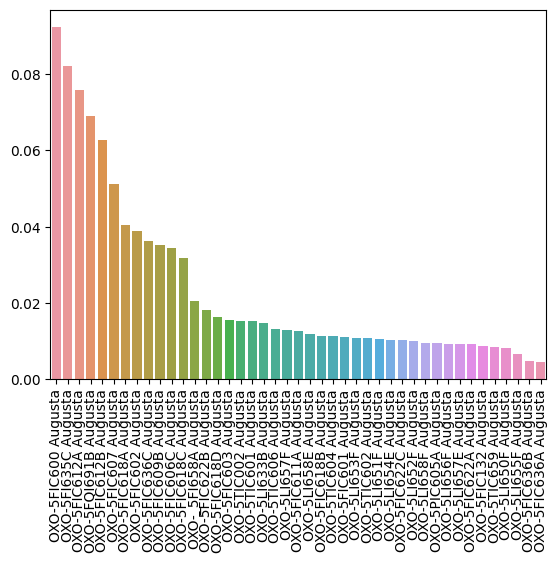

In [522]:
# print(best_estimator.feature_importances_)
feature_names = df_2.columns[1:]
feat_imps = zip(feature_names, best_estimator.feature_importances_)
feats, imps = zip(*(sorted(list(filter(lambda x: x[1] != 0, feat_imps)), key=lambda x: x[1], reverse=True)))
ax = sns.barplot(x=list(feats), y=list(imps))
ax.tick_params(axis='x', rotation=90)
print('Top 3 most important features from the trained XGBoost model:', feats[:3])

Validation

(2672,)


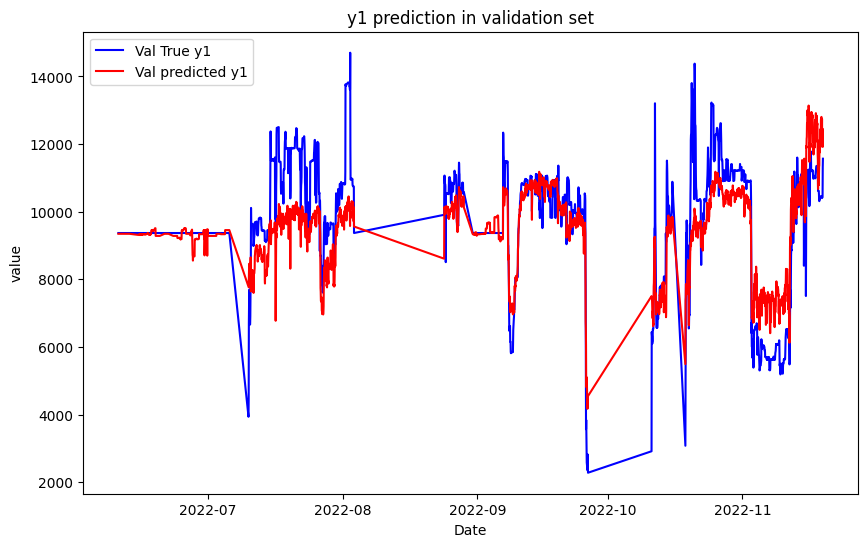

In [523]:
val_yhat = grid_search.predict(val_X)
print(val_yhat.shape)

plt.figure(figsize=(10,6))
plt.plot(df['Date'][train_size: train_size + val_size], val_y, color='blue', label='Val True y1')
plt.plot(df['Date'][train_size: train_size + val_size], val_yhat, color='red', label='Val predicted y1')
plt.title('y1 prediction in validation set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [524]:
rmse = np.sqrt(mean_squared_error(val_yhat, val_y))
print('Validation RMSE: %.3f' % rmse)

Validation RMSE: 1115.360


Test

(2674,)


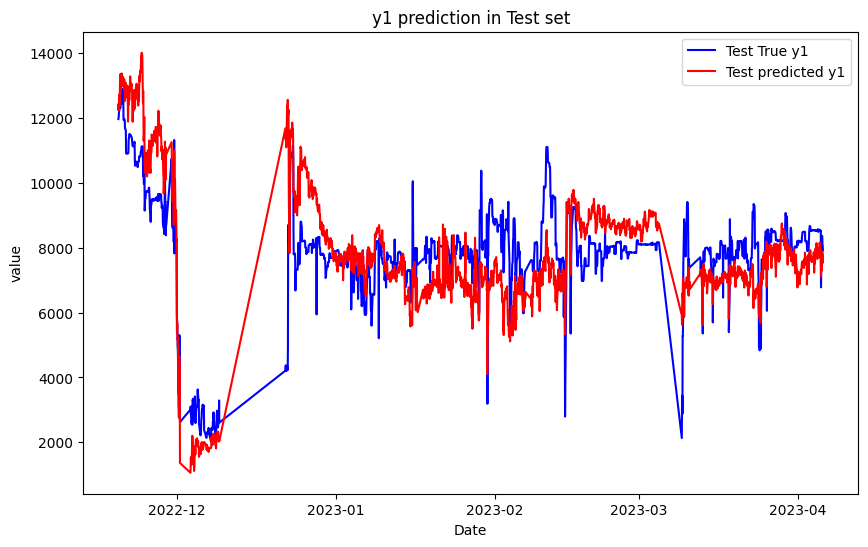

In [525]:
test_yhat = grid_search.predict(test_X)
print(test_yhat.shape)


plt.figure(figsize=(10,6))
plt.plot(df['Date'][-test_size:], test_y, color='blue', label='Test True y1')
plt.plot(df['Date'][-test_size:], test_yhat, color='red', label='Test predicted y1')
plt.title('y1 prediction in Test set')
plt.xlabel('Date')
plt.ylabel('value')
plt.legend()
plt.show()

In [526]:
rmse = np.sqrt(mean_squared_error(test_yhat, test_y))
print('Test RMSE: %.3f' % rmse)

Test RMSE: 1296.946
